# Proyek Akhir: Menyelesaikan Permasalahan Perusahaan Edutech

- Nama: Amalan Fadil Gaib
- Email:
- Id Dicoding:

## Persiapan

### Menyiapkan library yang dibutuhkan

In [1]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 1000) 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, OneHotEncoder, StandardScaler, RobustScaler, OrdinalEncoder, TargetEncoder
from sklearn.model_selection import train_test_split, StratifiedKFold, StratifiedGroupKFold, cross_val_score, KFold
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier, Pool
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score, confusion_matrix, classification_report
from sklearn.utils.class_weight import compute_class_weight
from imblearn.over_sampling import SMOTE
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer, KNNImputer
import optuna
import lime
import shap 
import joblib
from lime.lime_tabular import LimeTabularExplainer

### Menyiapkan data yang akan diguankan

## Data Understanding

In [2]:
df = pd.read_csv('https://github.com/dicodingacademy/dicoding_dataset/blob/f4a7541bc3dfca0012e20778e135c03b3e76dc67/students_performance/data.csv?raw=true', sep=';')
df

,Marital_status,Application_mode,Application_order,Course,Daytime_evening_attendance,Previous_qualification,Previous_qualification_grade,Nacionality,Mothers_qualification,Fathers_qualification,Mothers_occupation,Fathers_occupation,Admission_grade,Displaced,Educational_special_needs,Debtor,Tuition_fees_up_to_date,Gender,Scholarship_holder,Age_at_enrollment,International,Curricular_units_1st_sem_credited,Curricular_units_1st_sem_enrolled,Curricular_units_1st_sem_evaluations,Curricular_units_1st_sem_approved,Curricular_units_1st_sem_grade,Curricular_units_1st_sem_without_evaluations,Curricular_units_2nd_sem_credited,Curricular_units_2nd_sem_enrolled,Curricular_units_2nd_sem_evaluations,Curricular_units_2nd_sem_approved,Curricular_units_2nd_sem_grade,Curricular_units_2nd_sem_without_evaluations,Unemployment_rate,Inflation_rate,GDP,Status
0,1,17,5,171,1,1,122.0,1,19,12,5,9,127.3,1,0,0,1,1,0,20,0,0,0,0,0,0.000000,0,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,3,3,142.5,1,0,0,0,1,0,19,0,0,6,6,6,14.000000,0,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,9,9,124.8,1,0,0,0,1,0,19,0,0,6,0,0,0.000000,0,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,5,3,119.6,1,0,0,1,0,0,20,0,0,6,8,6,13.428571,0,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,9,9,141.5,0,0,0,1,0,0,45,0,0,6,9,5,12.333333,0,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,5,4,122.2,0,0,0,1,1,0,19,0,0,6,7,5,13.600000,0,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,9,9,119.0,1,0,1,0,0,0,18,1,0,6,6,6,12.000000,0,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,9,9,149.5,1,0,0,1,0,1,30,0,0,7,8,7,14.912500,0,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,7,4,153.8,1,0,0,1,0,1,20,0,0,5,5,5,13.800000,0,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4424 entries, 0 to 4423
Data columns (total 37 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   Marital_status                                4424 non-null   int64  
 1   Application_mode                              4424 non-null   int64  
 2   Application_order                             4424 non-null   int64  
 3   Course                                        4424 non-null   int64  
 4   Daytime_evening_attendance                    4424 non-null   int64  
 5   Previous_qualification                        4424 non-null   int64  
 6   Previous_qualification_grade                  4424 non-null   float64
 7   Nacionality                                   4424 non-null   int64  
 8   Mothers_qualification                         4424 non-null   int64  
 9   Fathers_qualification                         4424 non-null   i

In [4]:
df.describe()

,Marital_status,Application_mode,Application_order,Course,Daytime_evening_attendance,Previous_qualification,Previous_qualification_grade,Nacionality,Mothers_qualification,Fathers_qualification,Mothers_occupation,Fathers_occupation,Admission_grade,Displaced,Educational_special_needs,Debtor,Tuition_fees_up_to_date,Gender,Scholarship_holder,Age_at_enrollment,International,Curricular_units_1st_sem_credited,Curricular_units_1st_sem_enrolled,Curricular_units_1st_sem_evaluations,Curricular_units_1st_sem_approved,Curricular_units_1st_sem_grade,Curricular_units_1st_sem_without_evaluations,Curricular_units_2nd_sem_credited,Curricular_units_2nd_sem_enrolled,Curricular_units_2nd_sem_evaluations,Curricular_units_2nd_sem_approved,Curricular_units_2nd_sem_grade,Curricular_units_2nd_sem_without_evaluations,Unemployment_rate,Inflation_rate,GDP
count,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000
mean,1.178571,18.669078,1.727848,8856.642631,0.890823,4.577758,132.613314,1.873192,19.561935,22.275316,10.960895,11.032324,126.978119,0.548373,0.011528,0.113698,0.880651,0.351718,0.248418,23.265145,0.024864,0.709991,6.270570,8.299051,4.706600,10.640822,0.137658,0.541817,6.232143,8.063291,4.435805,10.230206,0.150316,11.566139,1.228029,0.001969
std,0.605747,17.484682,1.313793,2063.566416,0.311897,10.216592,13.188332,6.914514,15.603186,15.343108,26.418253,25.263040,14.482001,0.497711,0.106760,0.317480,0.324235,0.477560,0.432144,7.587816,0.155729,2.360507,2.480178,4.179106,3.094238,4.843663,0.690880,1.918546,2.195951,3.947951,3.014764,5.210808,0.753774,2.663850,1.382711,2.269935
min,1.000000,1.000000,0.000000,33.000000,0.000000,1.000000,95.000000,1.000000,1.000000,1.000000,0.000000,0.000000,95.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.600000,-0.800000,-4.060000
25%,1.000000,1.000000,1.000000,9085.000000,1.000000,1.000000,125.000000,1.000000,2.000000,3.000000,4.000000,4.000000,117.900000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,19.000000,0.000000,0.000000,5.000000,6.000000,3.000000,11.000000,0.000000,0.000000,5.000000,6.000000,2.000000,10.750000,0.000000,9.400000,0.300000,-1.700000
50%,1.000000,17.000000,1.000000,9238.000000,1.000000,1.000000,133.100000,1.000000,19.000000,19.000000,5.000000,7.000000,126.100000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,20.000000,0.000000,0.000000,6.000000,8.000000,5.000000,12.285714,0.000000,0.000000,6.000000,8.000000,5.000000,12.200000,0.000000,11.100000,1.400000,0.320000
75%,1.000000,39.000000,2.000000,9556.000000,1.000000,1.000000,140.000000,1.000000,37.000000,37.000000,9.000000,9.000000,134.800000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,25.000000,0.000000,0.000000,7.000000,10.000000,6.000000,13.400000,0.000000,0.000000,7.000000,10.000000,6.000000,13.333333,0.000000,13.900000,2.600000,1.790000
max,6.000000,57.000000,9.000000,9991.000000,1.000000,43.000000,190.000000,109.000000,44.000000,44.000000,194.000000,195.000000,190.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,70.000000,1.000000,20.000000,26.000000,45.000000,26.000000,18.875000,12.000000,19.000000,23.000000,33.000000,20.000000,18.571429,12.000000,16.200000,3.700000,3.510000


## Data Preparation / Preprocessing

In [5]:
df.drop(columns=['Status']).corr()

,Marital_status,Application_mode,Application_order,Course,Daytime_evening_attendance,Previous_qualification,Previous_qualification_grade,Nacionality,Mothers_qualification,Fathers_qualification,Mothers_occupation,Fathers_occupation,Admission_grade,Displaced,Educational_special_needs,Debtor,Tuition_fees_up_to_date,Gender,Scholarship_holder,Age_at_enrollment,International,Curricular_units_1st_sem_credited,Curricular_units_1st_sem_enrolled,Curricular_units_1st_sem_evaluations,Curricular_units_1st_sem_approved,Curricular_units_1st_sem_grade,Curricular_units_1st_sem_without_evaluations,Curricular_units_2nd_sem_credited,Curricular_units_2nd_sem_enrolled,Curricular_units_2nd_sem_evaluations,Curricular_units_2nd_sem_approved,Curricular_units_2nd_sem_grade,Curricular_units_2nd_sem_without_evaluations,Unemployment_rate,Inflation_rate,GDP
Marital_status,1.000000,0.264006,-0.125854,0.046365,-0.274939,0.062529,-0.022406,-0.008843,0.193163,0.130353,0.034994,0.031609,-0.004771,-0.234886,-0.028343,0.034304,-0.087158,-0.014738,-0.053765,0.522717,-0.027905,0.061209,0.052107,0.058030,-0.031027,-0.059811,0.034711,0.062831,0.039026,0.022784,-0.043739,-0.071506,0.020426,-0.020338,0.008761,-0.027003
Application_mode,0.264006,1.000000,-0.286357,0.065385,-0.304092,0.422411,-0.039020,-0.000661,0.118974,0.083276,0.051600,0.036707,-0.013271,-0.301197,-0.030779,0.122818,-0.136262,0.160130,-0.163117,0.516243,0.003438,0.247426,0.164299,0.225938,-0.029055,-0.117741,0.045828,0.238445,0.130046,0.167872,-0.071526,-0.115424,0.047983,0.089080,-0.016375,-0.022743
Application_order,-0.125854,-0.286357,1.000000,0.059507,0.158657,-0.184315,-0.064484,-0.022416,-0.064956,-0.050288,-0.039039,-0.030014,-0.096930,0.332362,0.025597,-0.072151,0.055891,-0.089559,0.073709,-0.271154,-0.028801,-0.133354,-0.016808,-0.092156,0.035580,0.058308,-0.031699,-0.125815,0.028878,-0.055089,0.071793,0.055517,-0.015757,-0.098419,-0.011133,0.030201
Course,0.046365,0.065385,0.059507,1.000000,-0.043151,0.006654,-0.081013,-0.033923,0.054543,0.050724,0.031265,0.028881,-0.125058,-0.087399,-0.018795,-0.032673,0.018381,-0.099571,0.017138,0.042994,-0.026737,-0.096335,0.328461,0.272845,0.180500,0.389349,0.034514,-0.089817,0.401539,0.278797,0.198032,0.348728,0.030816,0.007153,0.017710,-0.020265
Daytime_evening_attendance,-0.274939,-0.304092,0.158657,-0.043151,1.000000,-0.071871,0.052597,0.018530,-0.204767,-0.139894,-0.019067,-0.015477,0.007970,0.251767,0.031017,0.006658,0.038799,-0.012326,0.093912,-0.462280,0.027973,-0.127466,-0.043056,-0.045889,0.016935,0.063974,0.045630,-0.111953,0.000371,0.014610,0.034022,0.050493,-0.004229,0.061974,-0.024043,0.022929
Previous_qualification,0.062529,0.422411,-0.184315,0.006654,-0.071871,1.000000,0.104072,-0.029214,-0.013190,-0.006614,0.014822,0.016263,0.184183,-0.115188,-0.010461,0.095104,-0.068453,0.078684,-0.070513,0.156234,-0.026226,0.166025,0.078702,0.130597,0.022020,-0.000497,0.002887,0.143031,0.056179,0.114850,-0.008632,0.000942,0.005102,0.111958,-0.063736,0.064069
Previous_qualification_grade,-0.022406,-0.039020,-0.064484,-0.081013,0.052597,0.104072,1.000000,0.054088,-0.060670,-0.035234,-0.011415,-0.019284,0.580444,-0.011001,-0.001458,-0.037507,0.060578,-0.047874,0.055965,-0.111377,0.048529,-0.008872,-0.029169,-0.070702,0.048410,0.059438,-0.003926,-0.018489,-0.031649,-0.061355,0.050263,0.053239,-0.019015,0.045222,0.018710,-0.052620
Nacionality,-0.008843,-0.000661,-0.022416,-0.033923,0.018530,-0.029214,0.054088,1.000000,-0.049946,-0.085282,0.043187,0.020626,0.028176,-0.007448,-0.005982,0.051989,-0.026115,-0.023258,-0.010490,-0.003647,0.790935,-0.000370,-0.013292,-0.007763,-0.002268,0.000869,0.009145,-0.007278,-0.020113,-0.025721,-0.017880,-0.008497,-0.014041,-0.000651,-0.008922,0.034478
Mothers_qualification,0.193163,0.118974,-0.064956,0.054543,-0.204767,-0.013190,-0.060670,-0.049946,1.000000,0.535140,0.076772,0.052329,-0.054412,-0.081176,-0.021534,0.018774,-0.025665,-0.058753,0.045951,0.294614,-0.038504,0.046855,0.053664,0.045440,-0.011026,-0.036157,0.003183,

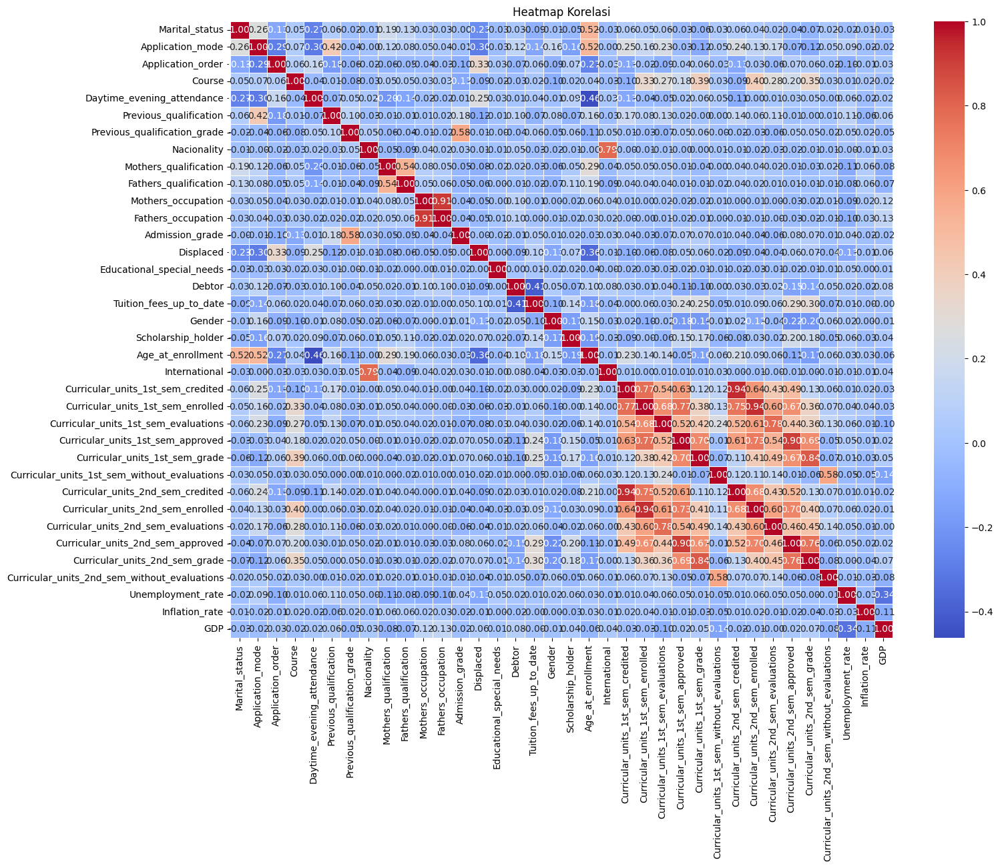

In [6]:
# Drop kolom Status sebelum korelasi
corr_matrix = df.drop(columns=['Status']).corr()

# Plot heatmap
plt.figure(figsize=(16, 12))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)
plt.title("Heatmap Korelasi")
plt.show()

In [7]:
numeric_features = df.select_dtypes(include=[np.number]).columns.tolist()
categorical_features = df.select_dtypes(include=['object']).columns.tolist()

# Pindahkan kolom numerik dengan unique values <= 3 ke categorical_features
for col in numeric_features[:]:  # Gunakan [:] agar tidak terjadi error saat mengubah list
    if df[col].nunique() <= 3:
        categorical_features.append(col)
        numeric_features.remove(col)

print(categorical_features)
print(numeric_features)

['Status', 'Daytime_evening_attendance', 'Displaced', 'Educational_special_needs', 'Debtor', 'Tuition_fees_up_to_date', 'Gender', 'Scholarship_holder', 'International']
['Marital_status', 'Application_mode', 'Application_order', 'Course', 'Previous_qualification', 'Previous_qualification_grade', 'Nacionality', 'Mothers_qualification', 'Fathers_qualification', 'Mothers_occupation', 'Fathers_occupation', 'Admission_grade', 'Age_at_enrollment', 'Curricular_units_1st_sem_credited', 'Curricular_units_1st_sem_enrolled', 'Curricular_units_1st_sem_evaluations', 'Curricular_units_1st_sem_approved', 'Curricular_units_1st_sem_grade', 'Curricular_units_1st_sem_without_evaluations', 'Curricular_units_2nd_sem_credited', 'Curricular_units_2nd_sem_enrolled', 'Curricular_units_2nd_sem_evaluations', 'Curricular_units_2nd_sem_approved', 'Curricular_units_2nd_sem_grade', 'Curricular_units_2nd_sem_without_evaluations', 'Unemployment_rate', 'Inflation_rate', 'GDP']


In [8]:
for col in categorical_features:
    print(f'{col} : {df[col].nunique()}')

Status : 3
Daytime_evening_attendance : 2
Displaced : 2
Educational_special_needs : 2
Debtor : 2
Tuition_fees_up_to_date : 2
Gender : 2
Scholarship_holder : 2
International : 2


In [9]:
for col in numeric_features:
    print(f'{col} : {df[col].nunique()}')

Marital_status : 6
Application_mode : 18
Application_order : 8
Course : 17
Previous_qualification : 17
Previous_qualification_grade : 101
Nacionality : 21
Mothers_qualification : 29
Fathers_qualification : 34
Mothers_occupation : 32
Fathers_occupation : 46
Admission_grade : 620
Age_at_enrollment : 46
Curricular_units_1st_sem_credited : 21
Curricular_units_1st_sem_enrolled : 23
Curricular_units_1st_sem_evaluations : 35
Curricular_units_1st_sem_approved : 23
Curricular_units_1st_sem_grade : 805
Curricular_units_1st_sem_without_evaluations : 11
Curricular_units_2nd_sem_credited : 19
Curricular_units_2nd_sem_enrolled : 22
Curricular_units_2nd_sem_evaluations : 30
Curricular_units_2nd_sem_approved : 20
Curricular_units_2nd_sem_grade : 786
Curricular_units_2nd_sem_without_evaluations : 10
Unemployment_rate : 10
Inflation_rate : 9
GDP : 10


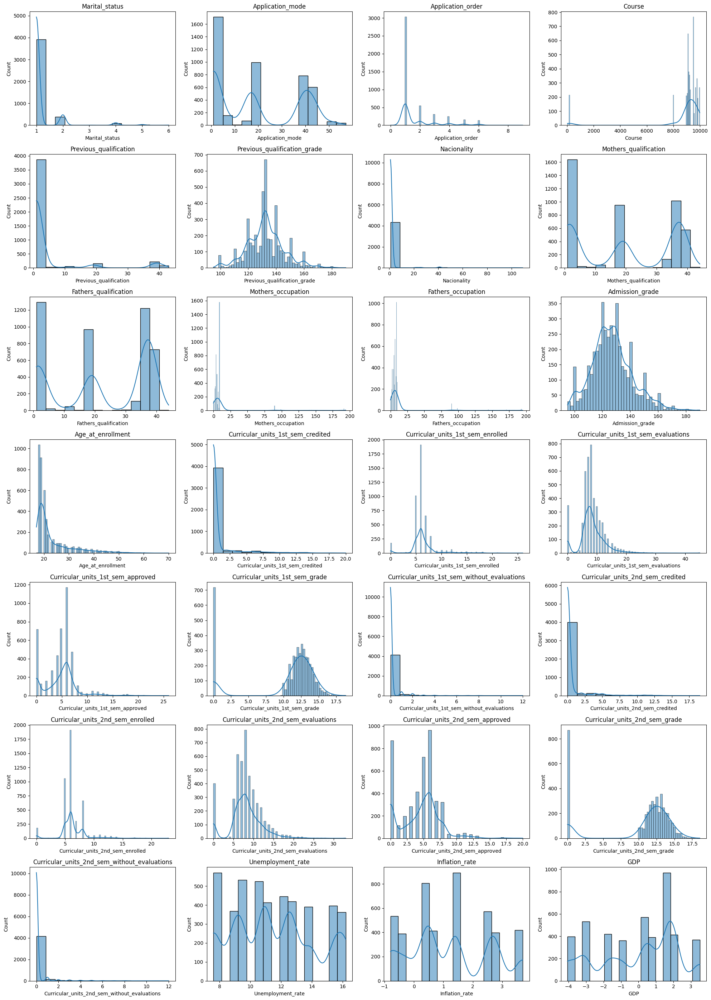

In [10]:
n = len(numeric_features)
width = 4
height = int(np.ceil(n / width))  # Konversi ke integer

fig, axes = plt.subplots(height, width, figsize=(5 * width, 4 * height))
axes = axes.flatten()

for i, col in enumerate(numeric_features):
    sns.histplot(data=df, x=col, kde=True, ax=axes[i])
    axes[i].set_title(col)

# Hapus subplot kosong yang tidak terpakai
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

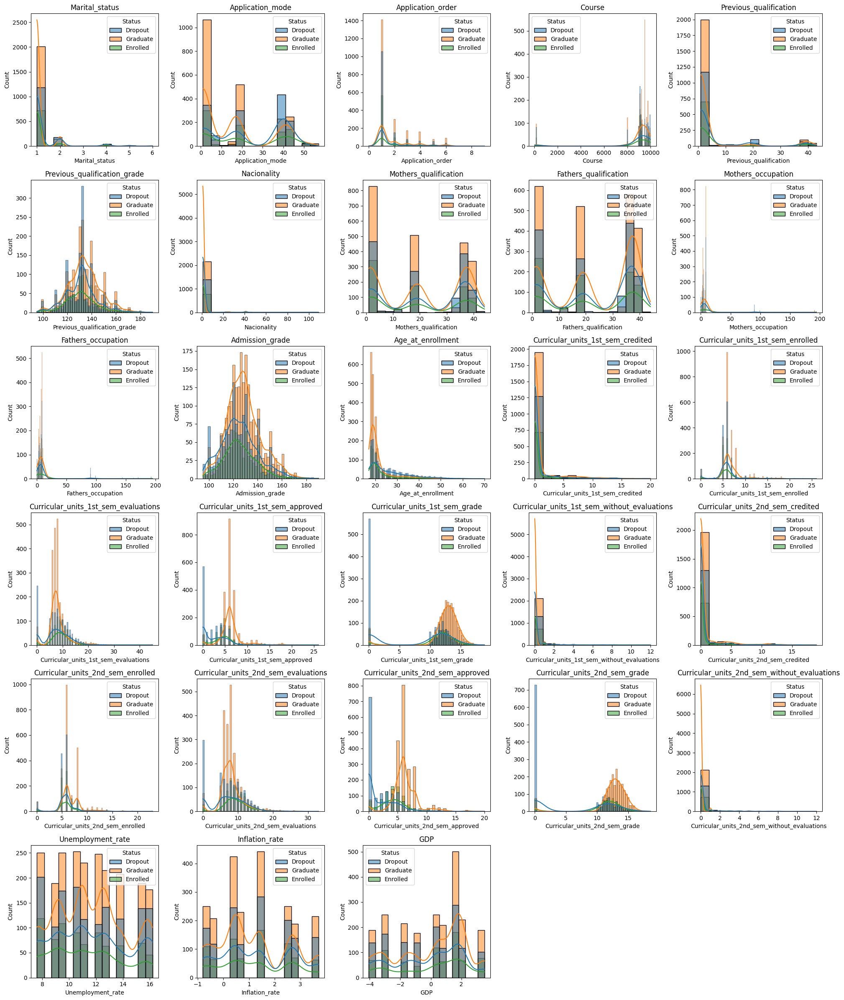

In [11]:
# Misalnya, df memiliki 26 kolom numerik
num_plots = len(numeric_features)
# Atur grid: misalnya 6 baris x 5 kolom (total 30 plot, kita akan gunakan 26)
nrows, ncols = 6, 5

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 24))
axes = axes.flatten()

for i, col in enumerate(numeric_features):
    sns.histplot(data=df, x=col, ax=axes[i], hue='Status', kde=True)
    axes[i].set_title(col)

# Hapus subplot kosong yang tidak digunakan
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

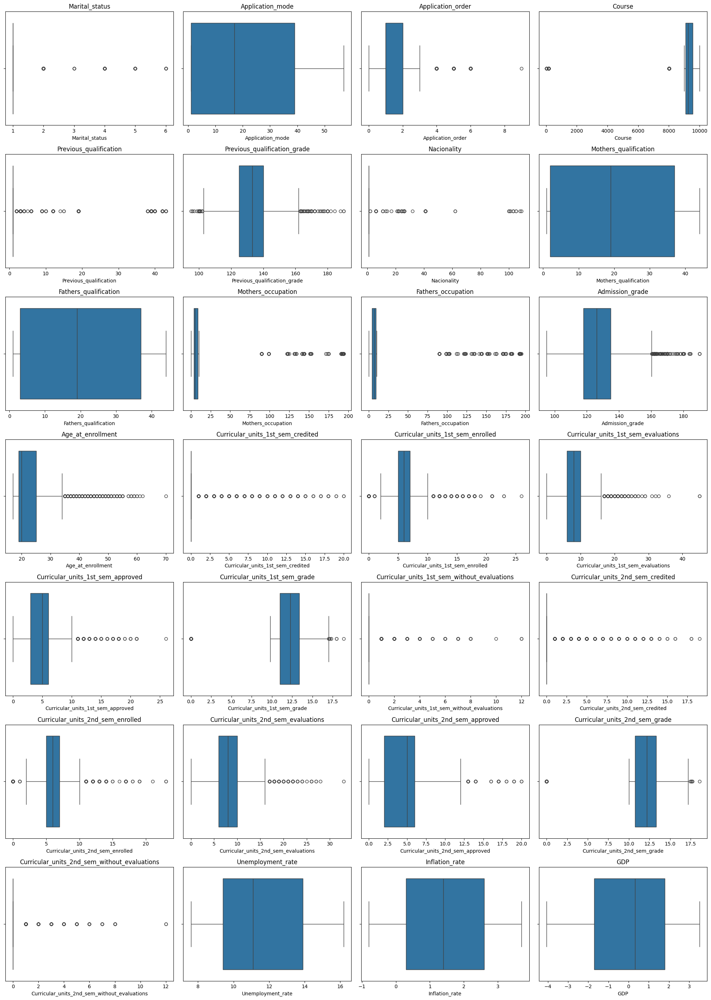

In [12]:
n = len(numeric_features)
width = 4
height = int(np.ceil(n / width))  # Konversi ke integer

fig, axes = plt.subplots(height, width, figsize=(5 * width, 4 * height))
axes = axes.flatten()

for i, col in enumerate(numeric_features):
    sns.boxplot(data=df, x=col, ax=axes[i])
    axes[i].set_title(col)

# Hapus subplot kosong yang tidak terpakai
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

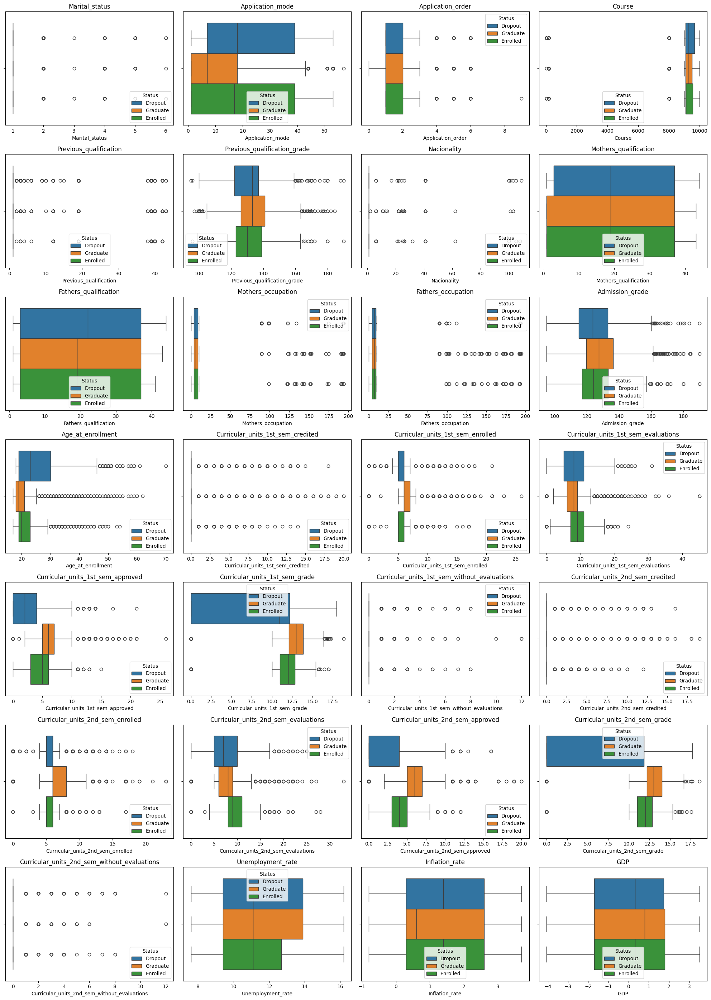

In [13]:
n = len(numeric_features)
width = 4
height = int(np.ceil(n / width))  # Konversi ke integer

fig, axes = plt.subplots(height, width, figsize=(5 * width, 4 * height))
axes = axes.flatten()

for i, col in enumerate(numeric_features):
    sns.boxplot(data=df, x=col, hue='Status',ax=axes[i])
    axes[i].set_title(col)

# Hapus subplot kosong yang tidak terpakai
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

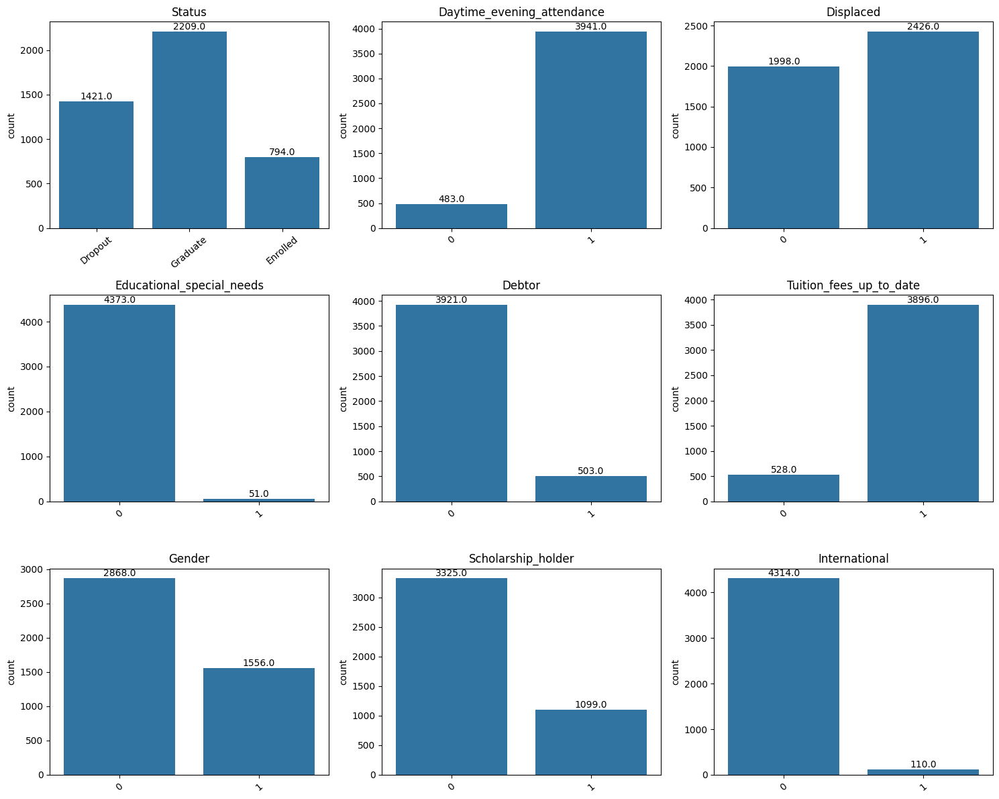

In [14]:
n = len(categorical_features)
width = 3
height = int(np.ceil(n / width))  # Konversi ke integer

fig, axes = plt.subplots(height, width, figsize=(5 * width, 4 * height))
axes = axes.flatten()

for i, col in enumerate(categorical_features):
    sns.countplot(data=df, x=col, ax=axes[i])
    axes[i].tick_params(axis='x', rotation=40)
    axes[i].set_xlabel('')
    axes[i].set_title(col)
    for p in axes[i].patches:
        height = p.get_height()
        axes[i].annotate(f'{height}',
                         (p.get_x() + p.get_width() / 2., height),
                         ha='center', va='center',
                         xytext=(0, 5),
                         textcoords='offset points')

# Hapus subplot kosong yang tidak terpakai
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

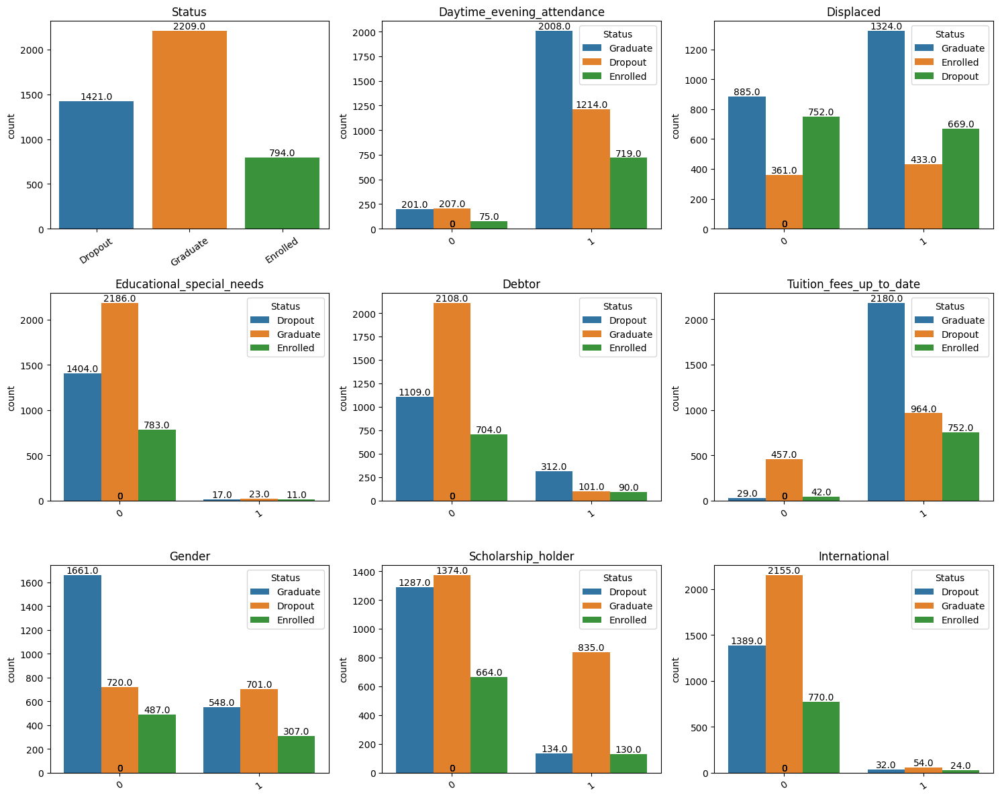

In [15]:
n = len(categorical_features)
width = 3
height = int(np.ceil(n / width))  # Konversi ke integer

fig, axes = plt.subplots(height, width, figsize=(5 * width, 4 * height))
axes = axes.flatten()

for i, col in enumerate(categorical_features):
    sns.countplot(data=df, x=col, ax=axes[i], hue='Status')
    axes[i].tick_params(axis='x', rotation=35)
    axes[i].set_xlabel('')
    axes[i].set_title(col)
    for p in axes[i].patches:
        height = p.get_height()
        axes[i].annotate(f'{height}',
                         (p.get_x() + p.get_width() / 2., height),
                         ha='center', va='center',
                         xytext=(0, 5),
                         textcoords='offset points')

# Hapus subplot kosong yang tidak terpakai
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [16]:
df['Status'].value_counts()

Status
Graduate    2209
Dropout     1421
Enrolled     794
Name: count, dtype: int64

In [17]:
print(f'kolom Status sebelum encoding : {df["Status"].unique()}')
le = LabelEncoder()
df['Status'] = le.fit_transform(df['Status'])
print(f'kolom Status setelah encoding : {df["Status"].unique()}')

kolom Status sebelum encoding : ['Dropout' 'Graduate' 'Enrolled']
kolom Status setelah encoding : [0 2 1]


## Data Preparation / Preprocessing

## Modeling

In [18]:
X = df.drop(columns=['Status'])
y = df['Status']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, stratify=y)
display(y_train.value_counts(normalize=True), y_test.value_counts(normalize=True))

Status
2    0.499294
0    0.321277
1    0.179429
Name: proportion, dtype: float64

Status
2    0.499435
0    0.320904
1    0.179661
Name: proportion, dtype: float64

In [31]:
import lightgbm
lgb = LGBMClassifier(n_estimators=10000,
                     n_jobs=-1,
                     random_state=42,
                     verbose=1)
                     
lgb.fit(X_train, y_train,
        eval_set=[(X_test, y_test)],
        callbacks=[lightgbm.early_stopping(stopping_rounds=500), lightgbm.log_evaluation(period=100)])

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0,026004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1288
[LightGBM] [Info] Number of data points in the train set: 3539, number of used features: 36
[LightGBM] [Info] Start training from score -1,135451
[LightGBM] [Info] Start training from score -1,717974
[LightGBM] [Info] Start training from score -0,694561
Training until validation scores don't improve for 500 rounds
[100]	valid_0's multi_logloss: 0.538226
[200]	valid_0's multi_logloss: 0.59818
[300]	valid_0's multi_logloss: 0.691481
[400]	valid_0's multi_logloss: 0.771063
[500]	valid_0's multi_logloss: 0.862455
Early stopping, best iteration is:
[65]	valid_0's multi_logloss: 0.522326


LGBMClassifier(n_estimators=10000, n_jobs=-1, random_state=42, verbose=1)

In [32]:
def evaluate_model(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print(f'accuracy: {accuracy_score(y_test, y_pred)}')
    print(f'recall: {recall_score(y_test, y_pred, average="weighted")}')
    print(f'precision: {precision_score(y_test, y_pred, average="weighted")}')
    print(f'f1 score: {f1_score(y_test, y_pred, average="weighted")}')
    print(classification_report(y_test, y_pred))
    print(confusion_matrix(y_test, y_pred))

In [33]:
evaluate_model(lgb, X_test, y_test)

accuracy: 0.7954802259887006
recall: 0.7954802259887006
precision: 0.7886331288994965
f1 score: 0.7890212789629084
              precision    recall  f1-score   support

           0       0.86      0.79      0.82       284
           1       0.57      0.47      0.51       159
           2       0.82      0.92      0.87       442

    accuracy                           0.80       885
   macro avg       0.75      0.72      0.73       885
weighted avg       0.79      0.80      0.79       885

[[223  29  32]
 [ 27  74  58]
 [  8  27 407]]


In [35]:
xgb = XGBClassifier(n_estimators=10000,
                    random_state=42,
                    n_jobs=-1,
                    eval_metric='auc',
                    objective='multi:softprob',
                    early_stopping_rounds=1000)
xgb.fit(X_train, y_train,
        verbose=100,
        eval_set=[(X_test, y_test)])

[0]	validation_0-auc:0.88966
[100]	validation_0-auc:0.90652
[200]	validation_0-auc:0.90561
[300]	validation_0-auc:0.90545
[400]	validation_0-auc:0.90402
[500]	validation_0-auc:0.90430
[600]	validation_0-auc:0.90398
[700]	validation_0-auc:0.90380
[800]	validation_0-auc:0.90351
[900]	validation_0-auc:0.90338
[1000]	validation_0-auc:0.90346
[1032]	validation_0-auc:0.90348


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=1000,
              enable_categorical=False, eval_metric='auc', feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=10000, n_jobs=-1,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [36]:
evaluate_model(xgb, X_test, y_test)

accuracy: 0.7751412429378531
recall: 0.7751412429378531
precision: 0.7652511799650011
f1 score: 0.7674285598079046
              precision    recall  f1-score   support

           0       0.83      0.77      0.80       284
           1       0.52      0.42      0.46       159
           2       0.81      0.91      0.86       442

    accuracy                           0.78       885
   macro avg       0.72      0.70      0.71       885
weighted avg       0.77      0.78      0.77       885

[[218  35  31]
 [ 31  66  62]
 [ 13  27 402]]


In [37]:
cat = CatBoostClassifier(n_estimators=10000,
                         random_state=42,
                         verbose=100,
                         early_stopping_rounds=1000,
                         thread_count=-1)
cat.fit(X_train, y_train,
        eval_set=[(X_test, y_test)])

Learning rate set to 0.045952
0:	learn: 1.0641200	test: 1.0647813	best: 1.0647813 (0)	total: 244ms	remaining: 40m 38s
100:	learn: 0.5507291	test: 0.5797152	best: 0.5797152 (100)	total: 2.37s	remaining: 3m 51s
200:	learn: 0.4876747	test: 0.5530580	best: 0.5530580 (200)	total: 4.18s	remaining: 3m 23s
300:	learn: 0.4416551	test: 0.5381742	best: 0.5381742 (300)	total: 7.5s	remaining: 4m 1s
400:	learn: 0.4077550	test: 0.5318487	best: 0.5318487 (400)	total: 9.21s	remaining: 3m 40s
500:	learn: 0.3759921	test: 0.5286345	best: 0.5286088 (488)	total: 11s	remaining: 3m 28s
600:	learn: 0.3484090	test: 0.5259674	best: 0.5258830 (597)	total: 13.2s	remaining: 3m 27s
700:	learn: 0.3218909	test: 0.5251110	best: 0.5249793 (660)	total: 14.6s	remaining: 3m 13s
800:	learn: 0.2988594	test: 0.5239978	best: 0.5235128 (755)	total: 17.3s	remaining: 3m 18s
900:	learn: 0.2770679	test: 0.5241867	best: 0.5229623 (813)	total: 19.1s	remaining: 3m 13s
1000:	learn: 0.2560697	test: 0.5243767	best: 0.5229623 (813)	total:

In [38]:
evaluate_model(cat, X_test, y_test)

accuracy: 0.7977401129943503
recall: 0.7977401129943503
precision: 0.7887557938552779
f1 score: 0.7888480355029133
              precision    recall  f1-score   support

           0       0.85      0.77      0.81       284
           1       0.60      0.45      0.52       159
           2       0.82      0.94      0.88       442

    accuracy                           0.80       885
   macro avg       0.76      0.72      0.73       885
weighted avg       0.79      0.80      0.79       885

[[219  31  34]
 [ 30  72  57]
 [ 10  17 415]]


## Evaluation

In [42]:
print("\nFeature Importance:")
feature_importance = lgb.feature_importances_  # Menggunakan feature_importances_ untuk LGBMClassifier
feature_names = X_train.columns if hasattr(X_train, 'columns') else [f'feature_{i}' for i in range(X_train.shape[1])]
for name, imp in zip(feature_names, feature_importance):
    print(f"{name}: {imp:.4f}")


Feature Importance:
Marital_status: 20.0000
Application_mode: 137.0000
Application_order: 88.0000
Course: 334.0000
Daytime_evening_attendance: 16.0000
Previous_qualification: 37.0000
Previous_qualification_grade: 429.0000
Nacionality: 13.0000
Mothers_qualification: 158.0000
Fathers_qualification: 184.0000
Mothers_occupation: 259.0000
Fathers_occupation: 243.0000
Admission_grade: 478.0000
Displaced: 57.0000
Educational_special_needs: 0.0000
Debtor: 76.0000
Tuition_fees_up_to_date: 121.0000
Gender: 58.0000
Scholarship_holder: 85.0000
Age_at_enrollment: 300.0000
International: 0.0000
Curricular_units_1st_sem_credited: 38.0000
Curricular_units_1st_sem_enrolled: 134.0000
Curricular_units_1st_sem_evaluations: 178.0000
Curricular_units_1st_sem_approved: 289.0000
Curricular_units_1st_sem_grade: 363.0000
Curricular_units_1st_sem_without_evaluations: 31.0000
Curricular_units_2nd_sem_credited: 30.0000
Curricular_units_2nd_sem_enrolled: 124.0000
Curricular_units_2nd_sem_evaluations: 243.0000
Curr

Admission_grade: 478.0000
Previous_qualification_grade: 429.0000
Curricular_units_2nd_sem_grade: 378.0000
Curricular_units_2nd_sem_approved: 378.0000
Curricular_units_1st_sem_grade: 363.0000
Course: 334.0000
Age_at_enrollment: 300.0000
Curricular_units_1st_sem_approved: 289.0000
Mothers_occupation: 259.0000
Fathers_occupation: 243.0000
Curricular_units_2nd_sem_evaluations: 243.0000
Unemployment_rate: 201.0000
GDP: 187.0000
Fathers_qualification: 184.0000
Curricular_units_1st_sem_evaluations: 178.0000
Mothers_qualification: 158.0000
Inflation_rate: 157.0000
Application_mode: 137.0000
Curricular_units_1st_sem_enrolled: 134.0000
Curricular_units_2nd_sem_enrolled: 124.0000
Tuition_fees_up_to_date: 121.0000
Application_order: 88.0000
Scholarship_holder: 85.0000
Debtor: 76.0000
Gender: 58.0000
Displaced: 57.0000
Curricular_units_1st_sem_credited: 38.0000
Previous_qualification: 37.0000
Curricular_units_1st_sem_without_evaluations: 31.0000
Curricular_units_2nd_sem_credited: 30.0000
Curricular

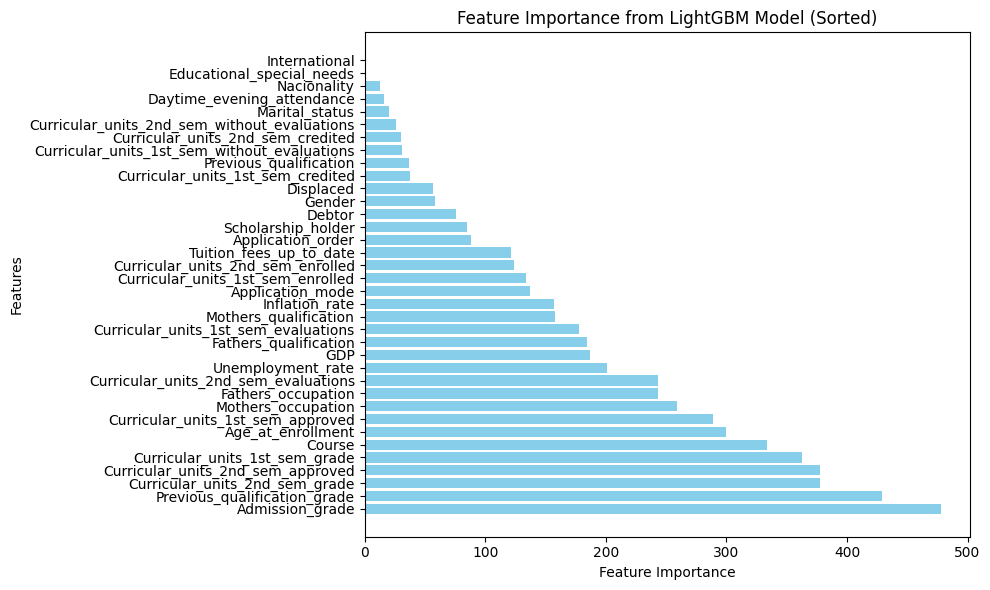

In [44]:
# Urutkan berdasarkan feature importance (dari tertinggi ke terendah)
sorted_idx = np.argsort(feature_importance)[::-1]
sorted_feature_importance = feature_importance[sorted_idx]
sorted_feature_names = [feature_names[i] for i in sorted_idx]

# Cetak nilai feature importance yang sudah diurutkan
for name, imp in zip(sorted_feature_names, sorted_feature_importance):
    print(f"{name}: {imp:.4f}")

# Membuat bar plot yang sudah diurutkan
plt.figure(figsize=(10, 6))
plt.barh(sorted_feature_names, sorted_feature_importance, color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance from LightGBM Model (Sorted)')
plt.tight_layout()
plt.show()

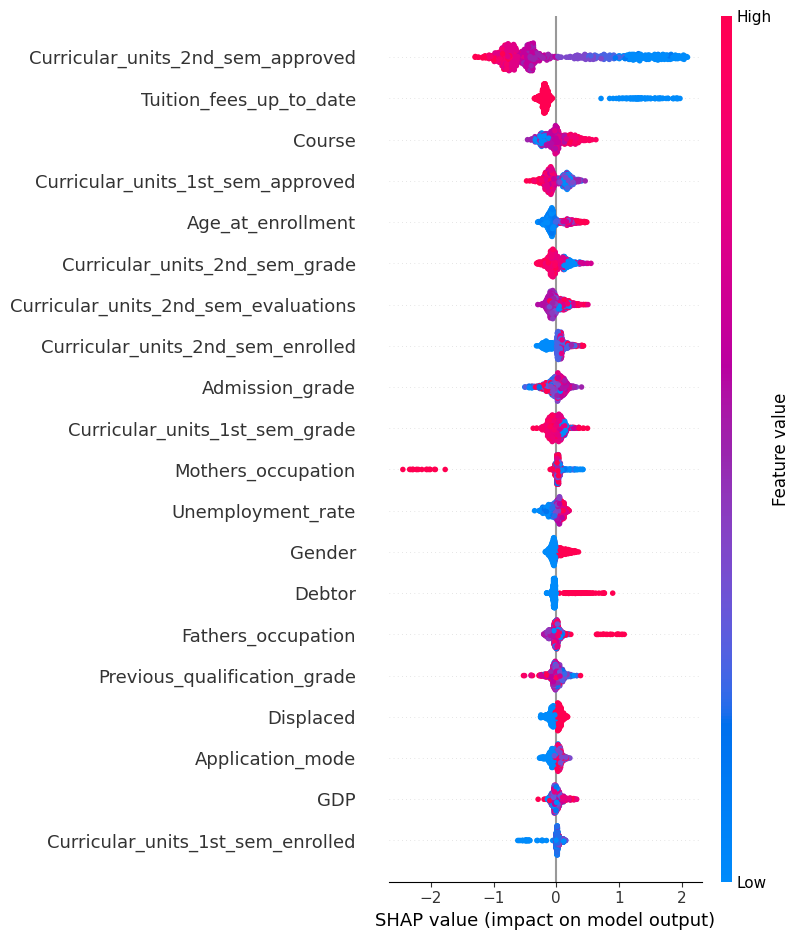

In [45]:
explainer = shap.Explainer(lgb)
shap_values = explainer(X_test) 
# Misalnya, ambil SHAP values untuk kelas pertama (indeks 0)
shap_values_class = shap_values[:, :, 0]  # Ambil nilai SHAP untuk kelas 0

# Buat summary plot
shap.summary_plot(shap_values_class, X_test, feature_names=X_test.columns if hasattr(X_test, 'columns') else None)

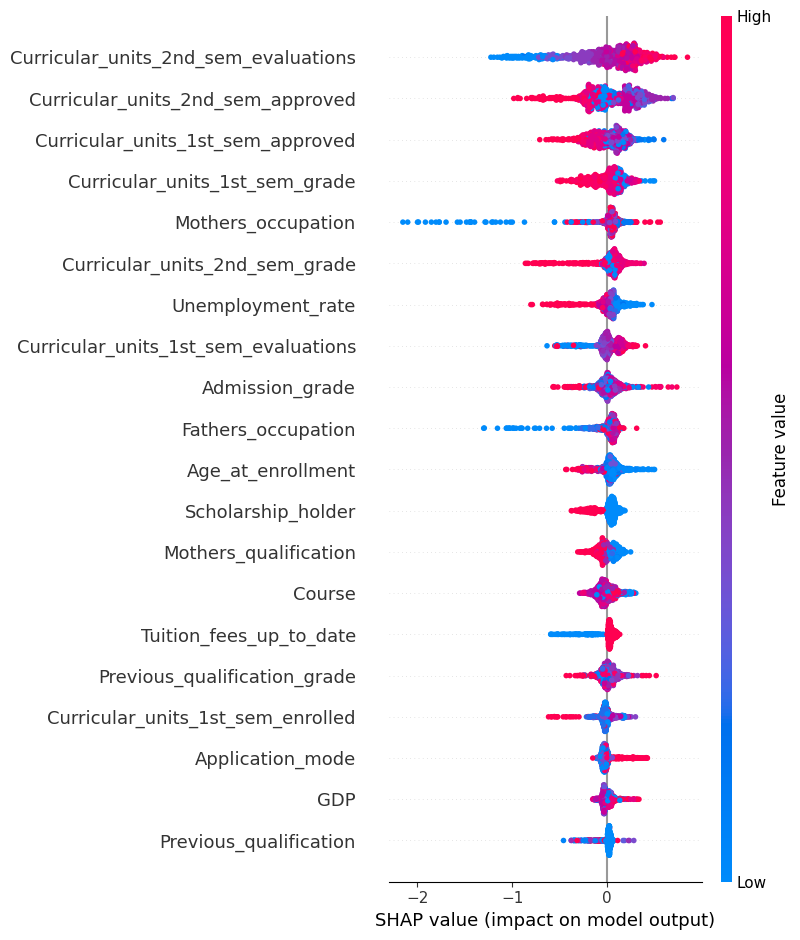

In [46]:
shap_values_class = shap_values[:, :, 1]  # Ambil nilai SHAP untuk kelas 1

# Buat summary plot
shap.summary_plot(shap_values_class, X_test, feature_names=X_test.columns if hasattr(X_test, 'columns') else None)

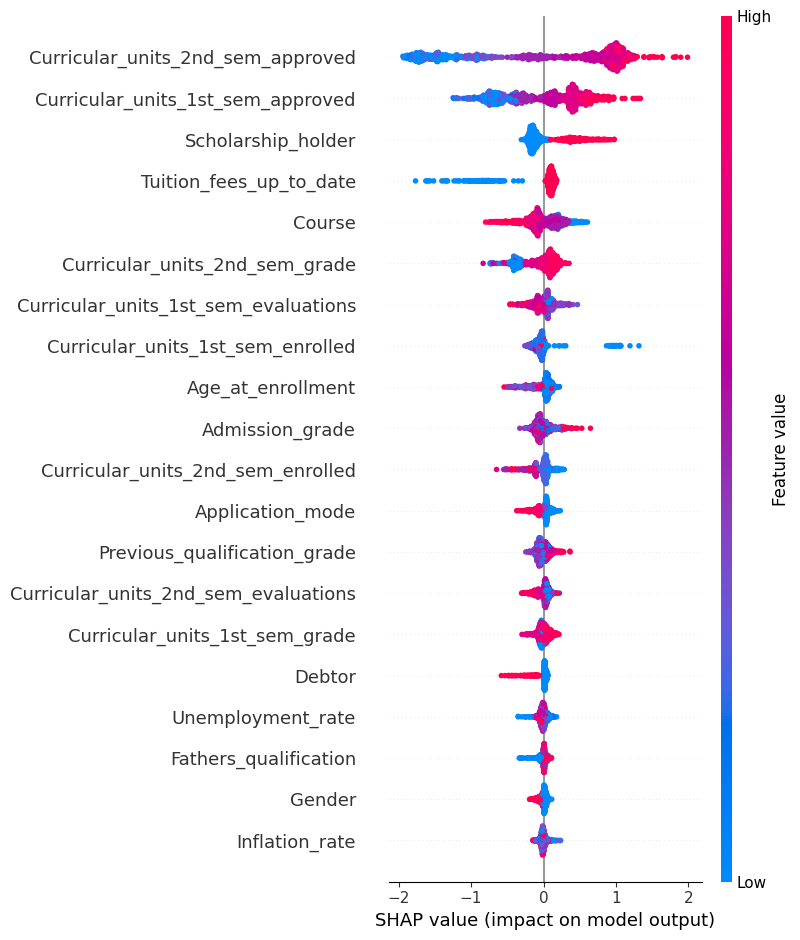

In [47]:
shap_values_class = shap_values[:, :, 2]  # Ambil nilai SHAP untuk kelas 2

# Buat summary plot
shap.summary_plot(shap_values_class, X_test, feature_names=X_test.columns if hasattr(X_test, 'columns') else None)

In [51]:
import lime.lime_tabular


explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    X_train.values, 
    mode='classification', 
    feature_names=X_train.columns.tolist(), 
    class_names=['Dropout', 'Enrolled', 'Graduate'], 
    discretize_continuous=True)

exp = explainer_lime.explain_instance(X_test.values[0],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [52]:
exp = explainer_lime.explain_instance(X_test.values[1],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [53]:
exp = explainer_lime.explain_instance(X_test.values[2],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [54]:
exp = explainer_lime.explain_instance(X_test.values[3],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [55]:
exp = explainer_lime.explain_instance(X_test.values[4],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [56]:
exp = explainer_lime.explain_instance(X_test.values[5],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [57]:
exp = explainer_lime.explain_instance(X_test.values[6],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [58]:
exp = explainer_lime.explain_instance(X_test.values[7],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [59]:
exp = explainer_lime.explain_instance(X_test.values[8],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [60]:
exp = explainer_lime.explain_instance(X_test.values[9],
                                      lgb.predict_proba, 
                                      num_features=15)
exp.show_in_notebook(show_table=True)

In [61]:
joblib.dump(lgb, 'model_lgb.pkl')

['model_lgb.pkl']

In [64]:
import pipreqs
!pipreqs --scan-notebooks --force 

Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
INFO: Successfully saved requirements file in d:\Python\Notebook\BPDS_2\requirements.txt
